# Lab 2: "Frequency domain coding"

* Student full name:
* Student email:

Please rename this notebook in order to include your name, e.g:

`Lab2_NameSurname.ipynb`

Next cells are required to set up the environment.

If you prefer, you can use any other signal as long as it has the same fs and is .wav


In [1]:
from pytube import YouTube
import subprocess

In [2]:
# Youtube
url = "https://www.youtube.com/watch?v=J7GY1Xg6X20"
output_file = ""

yt = YouTube(url)
audio_stream = yt.streams.filter(only_audio=True, file_extension='mp4').first()

if audio_stream:
    audio_stream.download(output_file)
    print(f"Downloaded: {output_file}")
else:
    print("No suitable audio stream found.")

Downloaded: 


In [3]:
cmd = [
    "ffmpeg", "-y", "-i", "test.m4a", "-ss", "22", "-t", "13", "-ac", "1",
    "-ar", "44100", "-acodec", "pcm_s16le", "speech.wav"
]

subprocess.run(cmd, stdout=subprocess.DEVNULL, stderr=subprocess.DEVNULL);

In [4]:
import os
import numpy as np
import matplotlib.pyplot as plt
import librosa
import huffman
from bitarray import bitarray
from IPython.display import Audio
import essentia.standard as es

def get_filesize(path):
    print("{0}: {1:.1f}KB".format(path, os.path.getsize(path) / 1000))
    return os.path.getsize(path) / 1000

def quantize(x, B):
    """ Quantize signal using B bits

    Args:
        x (numpy.array): Array of samples
        B (int): Number of bits
    """
    x = np.copy(np.array(x))
    quantized = np.round(x * 2**(B-1))
    quantized = np.minimum(quantized, 2**(B-1) - 1)
    quantized = np.maximum(quantized, -2**(B - 1))
    return quantized.reshape(x.shape)


def dequantize(codes, B):
    """ Dequantize signal using N bits

    Args:
        x (numpy.array): Array of samples
        B (int): Number of bits
    """
    return np.array(codes) / 2**(B - 1)

def get_prob_per_symbol(y):
    """ Get symbol occurrence probability

    Args:
        x (np.array): Input signal
    Returns:
        (dict): keys are symbols, values are probabilities
    """
    unique, counts = np.unique(y, return_counts=True)
    probabilities = counts / np.sum(counts)
    return unique, probabilities

def plot_spectrogram(X):
    plt.figure()
    plt.imshow(10*np.log10(np.abs(X) + 1e-6).T, origin='lower', aspect='auto')
    plt.colorbar()
    plt.xlabel('Frame')
    plt.ylabel('Frequency bin')
    plt.title('10 x log10(abs(X))')
    plt.show()

def get_low_amplitudes_codebook(b):
    # We create a synthetic codebook that favours low amplitudes
    symbols = np.arange(-(2**(b - 1)), 2**(b - 1), 1)
    probs = np.abs(symbols)
    probs = 2**(b - 1) - probs
    probs = 5 * probs / np.max(probs)
    probs = np.power(10, probs**2)
    probs = probs / np.sum(probs)
    symbol_probs = [(s, p) for (s, p) in zip(symbols, probs)]
    codebook = huffman.codebook(symbol_probs)
    huffman_dict = {}
    for (k, v) in codebook.items():
        huffman_dict[k] = bitarray(v)
    return huffman_dict

def flatten_complex_matrix(X):
    x = X.reshape(-1)
    x_real = np.real(x)
    x_imag = np.imag(x)
    x = np.concatenate([x_real, x_imag], axis=0)
    return x

def unflatten_array_to_complex_matrix(x, dst_shape):
    L = len(x)
    x_real = x[:L//2]
    x_imag = x[L//2:] * 1j
    x = x_real + x_imag
    return x.reshape(dst_shape).astype(np.complex64)

def save_quantized_array_to_file(x, B, path):
    quantized_x = quantize(x, B)
    x_bitarray = bitarray()
    x_bitarray.encode(get_low_amplitudes_codebook(B), quantized_x)
    with open(path, 'wb') as f:
        f.write(B.to_bytes(
            4, byteorder="little", signed=True))
        f.write(len(x_bitarray).to_bytes(
            4, byteorder="little", signed=True))
        x_bitarray.tofile(f)

def load_quantized_array_from_file(path):
    codes = bitarray()
    with open(path, 'rb') as f:
        B = int.from_bytes(
            f.read(4), byteorder="little", signed=True)
        L = int.from_bytes(
            f.read(4), byteorder="little", signed=True)
        codes.fromfile(f)
    quantized_y = codes[:L].decode(get_low_amplitudes_codebook(B))
    y = dequantize(quantized_y, B)
    return y

def save_quantized_complex_matrix_to_file(X, B, path):
    x = flatten_complex_matrix(X)
    quantized_x = quantize(x, B)
    x_bitarray = bitarray()
    x_bitarray.encode(get_low_amplitudes_codebook(B), quantized_x)
    with open(path, 'wb') as f:
        f.write(int(X.shape[0]).to_bytes(
            4, byteorder="little", signed=True))
        f.write(int(X.shape[1]).to_bytes(
            4, byteorder="little", signed=True))
        f.write(B.to_bytes(
            4, byteorder="little", signed=True))
        f.write(len(x_bitarray).to_bytes(
            4, byteorder="little", signed=True))
        x_bitarray.tofile(f)

def load_quantized_complex_matrix_from_file(path):
    codes = bitarray()
    with open(path, 'rb') as f:
        s0 = int.from_bytes(
            f.read(4), byteorder="little", signed=True)
        s1 = int.from_bytes(
            f.read(4), byteorder="little", signed=True)
        B = int.from_bytes(
            f.read(4), byteorder="little", signed=True)
        L = int.from_bytes(
            f.read(4), byteorder="little", signed=True)
        codes.fromfile(f)
    quantized_y = codes[:L].decode(get_low_amplitudes_codebook(B))
    y = dequantize(quantized_y, B)
    Y = unflatten_array_to_complex_matrix(y, (s0, s1))
    return Y

def save_quantized_real_matrix_to_file(X, B, path):
    x = X.reshape(-1)
    quantized_x = quantize(x, B)
    x_bitarray = bitarray()
    x_bitarray.encode(get_low_amplitudes_codebook(B), quantized_x)
    with open(path, 'wb') as f:
        f.write(int(X.shape[0]).to_bytes(
            4, byteorder="little", signed=True))
        f.write(int(X.shape[1]).to_bytes(
            4, byteorder="little", signed=True))
        f.write(B.to_bytes(
            4, byteorder="little", signed=True))
        f.write(len(x_bitarray).to_bytes(
            4, byteorder="little", signed=True))
        x_bitarray.tofile(f)


def load_quantized_real_matrix_from_file(path):
    codes = bitarray()
    with open(path, 'rb') as f:
        s0 = int.from_bytes(
            f.read(4), byteorder="little", signed=True)
        s1 = int.from_bytes(
            f.read(4), byteorder="little", signed=True)
        B = int.from_bytes(
            f.read(4), byteorder="little", signed=True)
        L = int.from_bytes(
            f.read(4), byteorder="little", signed=True)
        codes.fromfile(f)
    quantized_y = codes[:L].decode(get_low_amplitudes_codebook(B))
    y = dequantize(quantized_y, B)
    Y = y.reshape(s0, s1)
    return Y

# 1.Introduction

This lab has a goal:

**Store a decent quality audio file in disk with minimum storage**

The starting point is a high-quality WAV `speech.wav`: mono, 16 bits, 44100Hz. Its size is **819.3KB**.

Let's imagine we don't need so much audio quality in our use-case, e.g. this is going to be played in a small speaker.



In [5]:
get_filesize('speech.wav')

speech.wav: 441.1KB


441.078

In [6]:
Audio('speech.wav')

## 1.1.Time domain encoding

In Lab 1 our only tool was time domain encoding. Let's how much can we compress with it using 8 bits per sample and Huffman compression.

In [7]:
import essentia.standard as es
sr = 44100
audio = es.MonoLoader(filename='speech.wav')()
path = 'speech_timedomain.mycodec'
B = 8
save_quantized_array_to_file(audio, B, path)
get_filesize(path)

speech_timedomain.mycodec: 1274.1KB


1274.094

In [8]:
get_filesize('speech.wav') / get_filesize(path)

speech.wav: 441.1KB
speech_timedomain.mycodec: 1274.1KB


0.3461895276172715

In [9]:
y = load_quantized_array_from_file(path)
Audio(y, rate=sr)

Ok, we got ~3.3x compression, but we lost a lot of quality. These were our best tools up to now... but we can do it better with more tools.

## 1.2.Frequency domain coding

If we use a time-frequency representation, maybe we can do it better? Let's see.

We are going to experiment with two different frequency domain transformations:

* **Discrete Fourier Transform (DFT)**
* **Modified Discrete Cosine Transform (MDCT)**

These transformations can be computed very efficiently using the Fast Fourier Transform algorithm (FFT). The FFT is considered  **the most important numerical algorithm of our lifetime**.

The **DFT** is the basic frequency-domain transformation, conceptually easy to understand, and suitable for most kind of spectral analysis and spectral transformations. However, DFT is not very suitable for audio compression due to boundaries artifacts (you will listen to them in this lab). In order to overcome this problem, you have to use overlapping between windows, but it doubles the information that need to be stored: **not very good for compression**. This motivates the appearance of the Modified Discrete Cosine Transform (MDCT), which introduces some clever changes very convenient for audio compression.

The **MDCT** is a linear orthogonal lapped transform, based on the idea of time domain aliasing cancellation (TDAC). MDCT is critically sampled, which means that though it is 50% overlapped, a sequence data after MDCT has the same number of coefficients as samples before the transform (after overlap-and-add). This means, that a single block of IMDCT data does **not** correspond to the original block on which the MDCT was performed. When subsequent blocks of inverse transformed data are added (still using 50% overlap), the errors introduced by the transform **cancels out** (TDAC). Thanks to the overlapping feature, the MDCT is very useful for quantization. It effectively removes the otherwise easily detectable blocking artifact between transform blocks.

Both transformations are **invertible**: very convenient for encoding / decoding audio.

![](https://media.springernature.com/lw785/springer-static/image/chp%3A10.1007%2F978-1-4471-4905-7_2/MediaObjects/211701_1_En_2_Fig6_HTML.gif)

## 1.3.In this lab

We are going to:

* Create the spectrogram of an audio (using Essentia)
* Reconstruct the audio from the spectrogram using the IFFT and the overlap-add method.
* Quantize the spectrogram and listen to the boundaries artifacts.
* Solve these boundaries artifacts using window overlapping. Observe that the amount of information increases.
* Check why sub-bands might be convenient for frequency coding
* Do the same using the MDCT transformation, and observe that these problems dissapear.


# 2.Spectrogram using DFT
![](https://www.mathworks.com/help/dsp/ref/stft_output.png)

**a) The function `compute_spectrogram` is provided. Please, provide a general explanation about how it works, and comments to describe whatever you think it is interesting. Describe not only what it does, but also why it is implemented this way. Use extra code cells, running the building blocks separately, in order to illustrate your explanation. Use Essentia documentation is needed.**

**I need to know at what level are you understanding the whole process**

**e.g. how is frame generator working? difference between fft_size and hop_size? why do we need windowing? what data type is the output matrix? ...**

In [10]:
import essentia.standard as es

def compute_spectrogram(x, fft_size=1024, hop_size=1024, window_type='square'):
    """ Gets the spectrogram of waveform x

    Args:
        x (numpy.array): Array of samples
        fft_size (int): FFT size
        hop_size (int): Hop size between windows
        window_type (str): Window type (e.g. 'square' or 'hann')

    Returns:
        (np.array): Spectrogram with shape (num_frames, fft_size / 2 + 1)
    """
    w = es.Windowing(type=window_type)
    fft = es.FFT()
    spectrogram = []
    for frame in es.FrameGenerator(x,
                                   frameSize=fft_size,
                                   hopSize=hop_size,
                                   startFromZero=True):
        windowed_frame = w(frame)
        fft_windowed_frame = fft(windowed_frame)
        spectrogram.append(fft_windowed_frame)
    spectrogram = np.array(spectrogram)

    # We do this to use the full dynamic range before quantization:
    spectrogram /= np.max(np.abs(spectrogram))

    return spectrogram

### Spectrogram: What is it?
- A spectrogram in digital signal processing is computed using the STFT (short time fourier transform), which takes an incoming signal $x[n]$ and computes its discrete fourier transform $X[k]$ for a certain number of frames. 

### Spectrogram: What are the parameters of the STFT?
- The DFT/FFT operates on fixed sizes that denote the number of samples. A higher number of samples implies that the fft will have a higher frequency resolution, but suffer in terms of time resolution. 
- The hop size on the other hand denotes the interval / number of samples that are taken for each frame. This sequence of frames is what gives us the spectrogram, i.e. frequency magnitude/phase representation of our signal over time. 
- To obtain the signal $x[n]$ from its spectrogram, the hop size must be at most half of the fft size (with the exception of the square window), since frames are stitched back together using the overlap and add method.

### Spectrogram: Representation
- We typically visualise the spectrogram of a signal as a 3D function/vector, where one axis denotes type (typically the x axis), one axis denotes frequency (typically the y axis) and the final axis denotes the magnitude (usually in terms of a colour map). 

### *Compute_Spectrogram()*: General
- The function *compute_spectrogram()* computes the stft for a fixed fft and hop size of a signal *x* for a given window.  
- After creating a window and an fft object, the frames with the given parameters are generated. 

### *Compute_Spectrogram()*: Windowing 
- For each frame, the frame is windowed/tapered, the fft of the frame is computed and added to the spectrogram, giving us a 3D vector.
- In the context of dsp, windowing is used to avoid spectral leakage. If we use no window (essentially a rectangular window), artefacts are generated called "sidelobes", derived from the fact that the fourier transform of a rectangular signal is a sinc. Windowing can help reduce the spectral leakage and the level of the sidelobes, giving us a more accurate representation of the magnitude of each frequency component or frequency bin.

### *Compute_Spectrogram()*: Frame Generator
- The essentia frame generator takes our input array x and automatically segments it, generating the overlapping frames, resulting in a collection of overlapping frames (i.e. representation of our frequency spectrum over time).

### *Compute_Spectrogram()*: Output Array/Matrix Data Type
- The initial spectrogram list is converted to a numpy darray and then normalised.

**b) Load the audio file `speech.wav` and compute its spectrogram using fft_size=1024, hop_size=512, window_type=`hann`**

In [11]:
sr = 44100
audio = es.MonoLoader(filename='speech.wav')()

x = audio
fft_size = 1024
hop_size = 512

speech_spectrogram = compute_spectrogram(x, fft_size, hop_size, window_type="hann")
np.shape(speech_spectrogram)

(1722, 513)

**c) Plot the spectrogram using `plot_spectrogram()`. If the spectrogram is a complex matrix, how can we represent it as an 2D image? What information are we losing in this representation?**

**Optional: why are we missing the very high frequencies?**

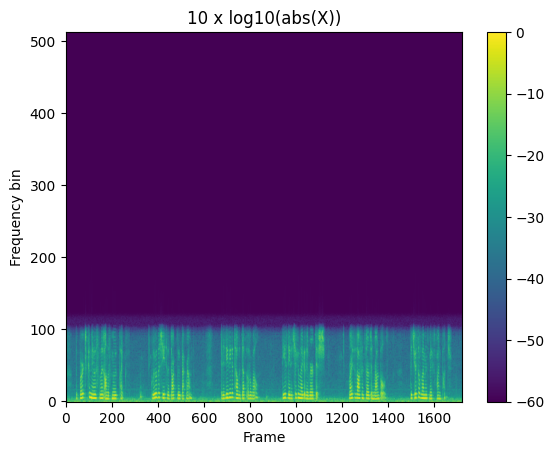

In [12]:
plot_spectrogram(speech_spectrogram)

The FFT will return an array of complex exponentials. However, there exist a property in signal theory that states that the fourier transform of a real-valued signal will also be a real-values signal. Hence, if the speech signal is real, as should be the case, its fourier transform will also be real. In any case, the representation of the spectrogram is typically only given of the magnitude spectrum:

Let $x[n]$ be the original signal and $X[k]$ its discrete fourier transform. Then the magnitude spectrum will be given by $|X[k]| = abs(X[k])$. If $x[n] \in R$, then $|X[k]| = Real(X[k])$. The information that is missing in this representation is the phase $\angle{X[k]}$.

We may be missing the higher frequencies because, although the sampling frequency is $f_s = 44110$, the original signal may actually be a downsampled version. It could also be the case that the signal was initially recorded at a lower sample rate and then upsampled to $44100$.

**d) How many float numbers contains the waveform? How many float numbers contains the spectrogram? Note that the spectrogram is made of complex values.**

### Number of floating point numbers of the speech signal:

In [13]:
len(audio)

882000

### Nuber of floating point numbers of the spectrogram

Each complex number is represented as two floating point numbers, one for the real part and one for the imaginary part.

In [14]:
def compute_num_floats_in_complex_matrix(spectrogram: np.ndarray, fft_size):
    num_frames          = spectrogram.shape[0]    # number of frames in our spectrogram
    num_complex_values  = fft_size//2 + 1               # due to conjugate symmetry
    num_float_per_val   = 2

    total_num_floats    = num_frames * num_complex_values * num_float_per_val
    print("The total number of floats will be:", total_num_floats)
    return total_num_floats


In [15]:
# Number of floating point numbers of the spectrogram:
num_floats = compute_num_floats_in_complex_matrix(spectrogram=speech_spectrogram, fft_size=fft_size)

The total number of floats will be: 1766772


# 3.Overlap-add method to resynthesize audio from spectrogram

With overlap-add method we can implement the full chain:


**Audio waveform→Spectrogram→Quantized spectrogram→Audio waveform**


![](https://www.researchgate.net/profile/Tom_Baeckstroem/publication/330871136/figure/fig1/AS:722794081959936@1549338946672/Illustration-of-input-and-output-windowing-with-overlap-add-synthesis-in-a-speech_W640.jpg)

**a) The function `compute_inverse_spectrogram` is provided. Please, provide a general explanation about how it works, and comments to describe whatever you think it is interesting. Describe not only what it does, but also why it is implemented this way. Use extra code cells, running the building blocks separately, in order to illustrate your explanation. Use Essentia documentation is needed.**

**e.g. why do we need overlap-add? would we need it if fft_size = hop_size? in which conditions overlap-add is able to properly reconstruct the signal?...**

**Extra question to be answered: the object `overlap_add` has memory and it uses information from previous iterations in every new iteration. Why?**

In [16]:
def compute_inverse_spectrogram(X, fft_size=1024, hop_size=1024):
    """ Gets the waveform from a spectrogram X

    Args:
        x (numpy.array): Array of samples
        fft_size (int): FFT size
        hop_size (int): Hop size between windows
        window_type (str): Window type (e.g. 'square' or 'hann')

    Returns:
        (np.array): Spectrogram with shape (num_frames, fft_size / 2 + 1)
    """
    overlap_add = es.OverlapAdd(frameSize=fft_size, hopSize=hop_size)
    ifft = es.IFFT()
    y = np.array([], dtype=np.float32)
    
    for fft_windowed_frame in X:
        windowed_frame = ifft(fft_windowed_frame)
        frame_overlapped = overlap_add(windowed_frame)
        y = np.append(y, frame_overlapped)
    return y

### Compute_Inverse_Spectrogram(): How it works
- The function takes the argument X, the spectrogram representation of our signal, denoted mathematically as $X_l[k]$ where the sub-index $l$ denotes the frame.
  

1. The function first creates an *OverlappAdd* object and an IFFT object, both of which are part of the base class of "Essentia Algorithms".

In [17]:
overlapp_add    = es.OverlapAdd(frameSize = fft_size, hopSize = hop_size)
ifft            = es.IFFT()

print(type(overlapp_add))
print(type(ifft))

<class 'essentia.standard._create_essentia_class.<locals>.Algo'>
<class 'essentia.standard._create_essentia_class.<locals>.Algo'>


2. For each frame within our numpy array, we iterate over the frames and obtain the windowed version of the frame in time-domain representation, in other words: $wx_l[n] = w[n] \cdot x_l[n]$

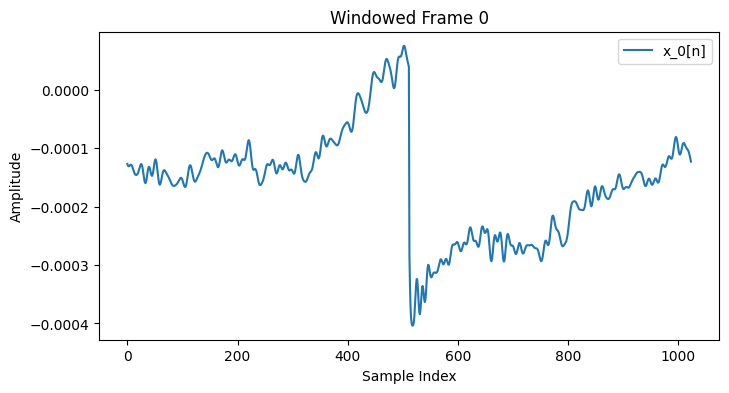

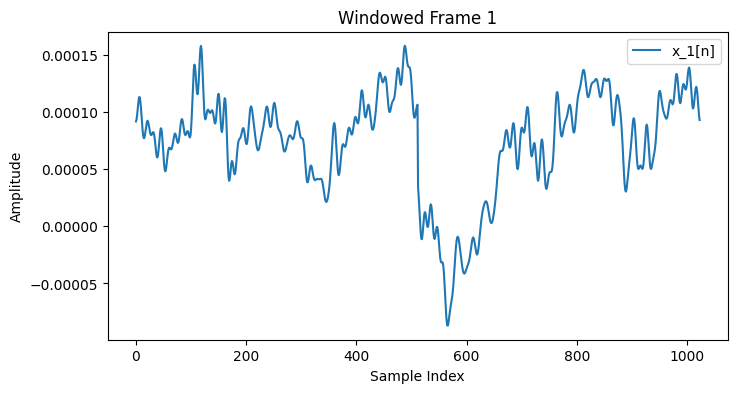

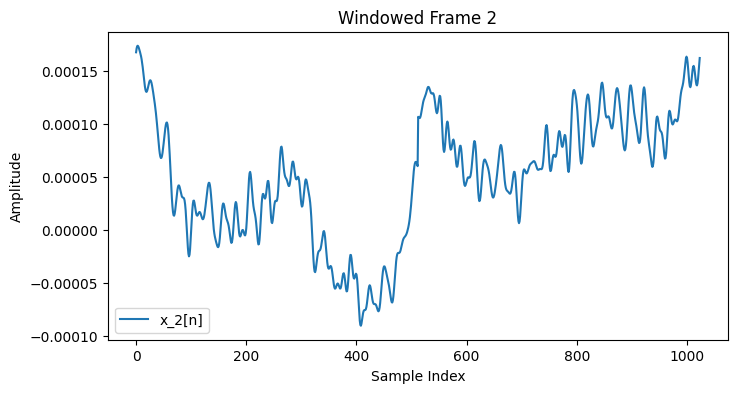

In [18]:
X = compute_spectrogram(audio)
windowed_frames = []

for fft_windowed_frame in X:
        windowed_frame = ifft(fft_windowed_frame)
        windowed_frames.append(windowed_frame)

# Plotting the first 3 windowed frames
for l in range(3):
    plt.figure(figsize=(8, 4))
    plt.plot(windowed_frames[l], label=f'x_{l}[n]')
    plt.title(f"Windowed Frame {l}")
    plt.xlabel("Sample Index")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.show()
    

3. We then apply then overlap and add, that is, we take the frame and overlap it with the previously computed frames.

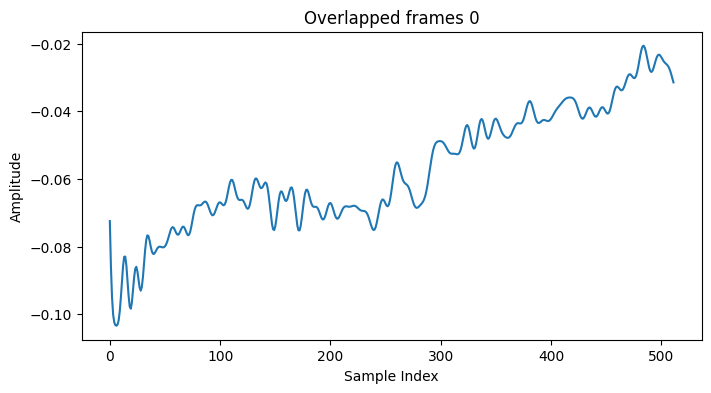

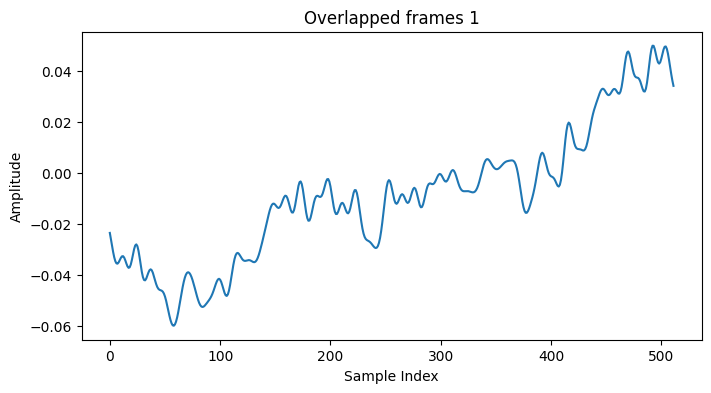

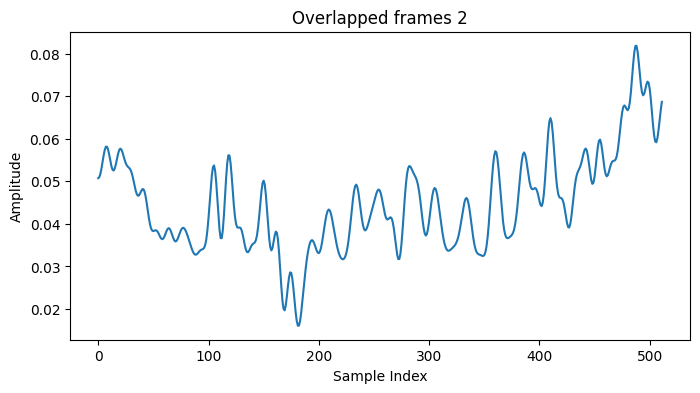

In [19]:
overlapped_frames = []
for fft_windowed_frame in X:
        windowed_frame = ifft(fft_windowed_frame)
        frame_overlapped = overlapp_add(windowed_frame)
        overlapped_frames.append(frame_overlapped)

for l in range(3):
    plt.figure(figsize=(8, 4))
    plt.plot(overlapped_frames[l])
    plt.title(f"Overlapped frames {l}")
    plt.xlabel("Sample Index")
    plt.ylabel("Amplitude")
    plt.show()

4. Finally, we extract the frame from the overlap_add object and reconstruct the entire signal by concatenating all of the frames.

Text(0, 0.5, 'Amplitude')

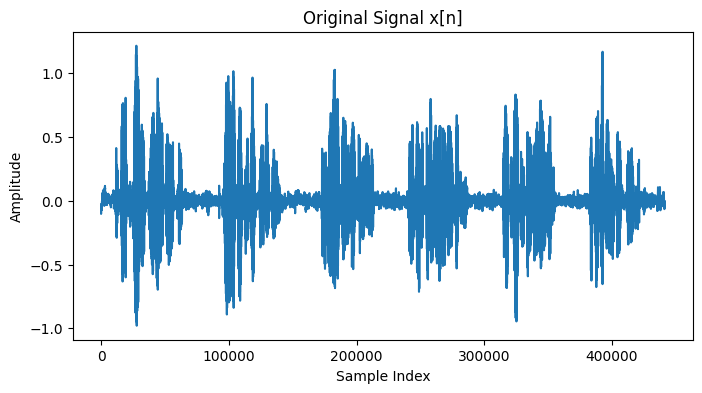

In [20]:
y = np.array([])

for fft_windowed_frame in X:
        windowed_frame = ifft(fft_windowed_frame)
        frame_overlapped = overlapp_add(windowed_frame)
        y = np.append(y, frame_overlapped)

plt.figure(figsize=(8, 4))
plt.plot(y)
plt.title(f"Original Signal x[n]")
plt.xlabel("Sample Index")
plt.ylabel("Amplitude")

### STFT: Why Overlap and Add?
- The overlap and add algorithm is needed in particular to reconstruct the original signal from the frames of the stft

### STFT: Recovering a Signal
- As stated above, a signal $X_l[k]$ computed using the STFT can be recovered and reconstructed perfectly using the overlap and add method, if and only if the hop size $H = l_{fft} / 2$. Alternatively, we can say that a signal can be perfectly reconstructed, whenever the sum of all windows equals a constant. Mathematically:

- $A_w[n] = \sum_{l = 0}^{L - 1} w[n - l] = c$


### STFT: Why Store Previous Frames in Memory?
- The *Overlap and Add* algorithm stores the previous frames in memory, since the contribution of the previous frames is necessary to reconstruct the signal. Depending on the hop size, it may need more or less windows to obtain the original signal $x[n]$. 


**b) Compute the spectrogram of `speech.wav` and the inverse spectrogram in order to resynthesize the audio from it. Listen to the resulting audio, how does it sound? Why?**

Assuming that the condition for perfect reconstruction is satisfied, both audio files will sound the same

In [21]:
spectrogram      = compute_spectrogram(audio, fft_size=1024, hop_size=512)
reconstruction  = compute_inverse_spectrogram(speech_spectrogram, fft_size=1024, hop_size=512)

### Original Signal

In [22]:
Audio(data = audio, rate = 44100)

### Reconstructed Signal

In [23]:
Audio(data = reconstruction, rate = 44100)

**c) Play with different settings: various frame_sizes (typically $2^n$: e.g. 1024, 2048...), various hop_sizes (typically `frame_size`, `frame_size / 2`, or `frame_size / 4`), and several window_types (e.g. `hann` or `square`).**

**Typically, `frame_size` will be the same in `compute_spectrogram` and `compute_inverse_spectrogram`, but `hop_size` can be different (leading to interesting effects).**

**Describe systematically your experiments and conclusions. If you understand the concepts, probably you will able to illustrate something interesting about windowing, overlap-add method, etc.**

**e.g. if we use `hann` window, fft_size=hop_size, do we achieve a good audio reconstruction?**



### Comparing a Hann Window to a Rectangular Window 

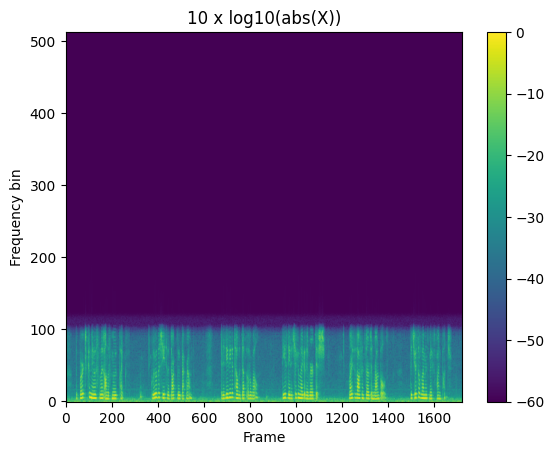

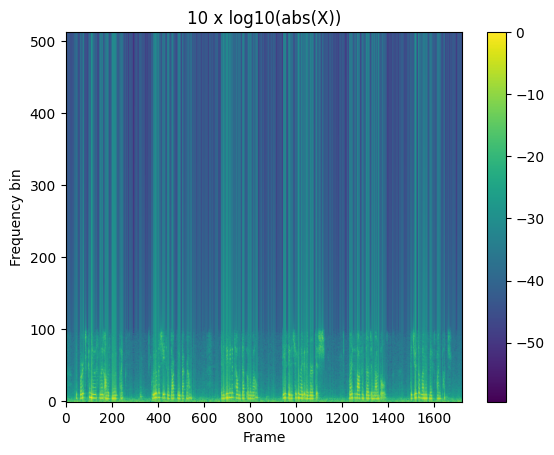

In [24]:
fft_size = 1024
hop_size = fft_size//2
spectrogram_hann = compute_spectrogram(audio, hop_size = hop_size, fft_size = fft_size, window_type="hann")      # Max hop size, hann window
spectrogram_rect = compute_spectrogram(audio, hop_size = hop_size, fft_size = fft_size, window_type="square")    # Max hop size, Rectangular window

plot_spectrogram(spectrogram_hann)
plot_spectrogram(spectrogram_rect)

We can clearly see the spectral leakage in the higher frequencies of the signal that uses a rectangular window. Where previously there was no high frequency content in the signal, we now have the highest frequency bin repeating for all other signals. This is because we are essentially obtaining the frequency response of a $sinc$ function, which is a periodic, infinitely repeating function.

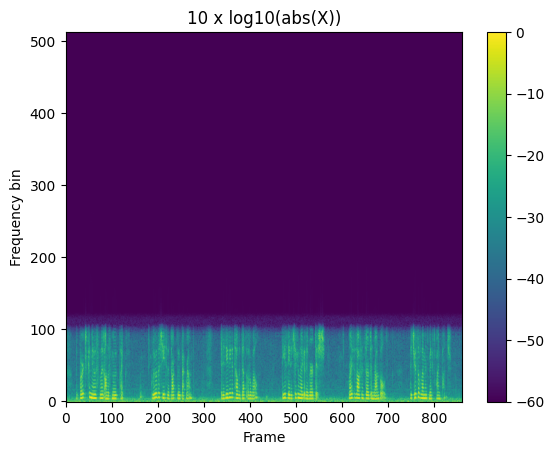

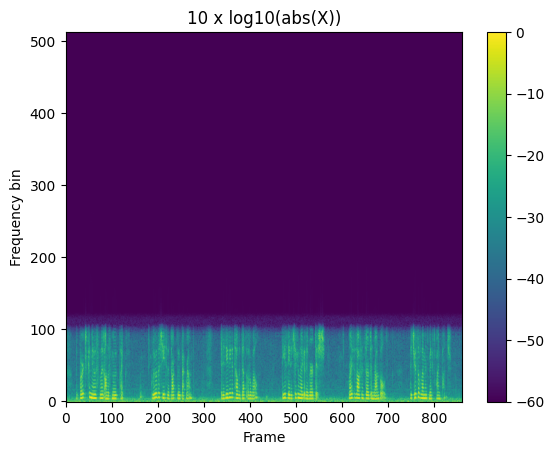

In [25]:
fft_size = 1024
hop_size = fft_size
spectrogram_max_hop      = compute_spectrogram(audio, hop_size = hop_size, fft_size = fft_size, window_type="hann")      # Max hop size, hann window
spectrogram_large_hop    = compute_spectrogram(audio, hop_size = hop_size, fft_size = fft_size, window_type="hann")      # Hop size too big, hann window

plot_spectrogram(spectrogram_max_hop)
plot_spectrogram(spectrogram_large_hop)

If we choose a hop size that is too large and doesn't satisfy the reconstruction condition mentioned previously, the signal looses upon time resolution. The jumps between frames is too large and the signal is poorly reconstructed, as there are entire chunks of signal that are missing. We can further demonstrate this by reconstructing the audio file (with a less dramatic difference between hop size and fft size).  

In [26]:
fft_size = 1024
hop_size = 1024

spectrogram_equal   = compute_spectrogram(audio, hop_size = fft_size, fft_size = fft_size, window_type="hann")      # hop size = fft size, hann window
reconstructed_equal = compute_inverse_spectrogram(spectrogram_equal, hop_size=hop_size, fft_size=fft_size)

Audio(data = reconstructed_equal, rate = 44100) 


Here we can clearly hear the "gaps" between different frames due to the fact that the reconstruction condition is not satisfied. However, if the window is rectangular, then reconstruction can still be achieved if hop_size = fft_size, as the segments are not tapered at the ends and can simply be appended or concatenated as a sequence. 

In [27]:
fft_size = 1024
hop_size = 1024

spectrogram_equal   = compute_spectrogram(audio, hop_size = fft_size, fft_size = fft_size, window_type="square")      # hop size = fft size, hann window
reconstructed_equal = compute_inverse_spectrogram(spectrogram_equal, hop_size=hop_size, fft_size=fft_size)

Audio(data = reconstructed_equal, rate = 44100) 

# 4.Quantizing the spectrogram

**a) Compute the spectrogram of `speech.wav`, quantize it using 8 bits, and resynthesize audio from it. Use `square` window with fft_size=2048, hop_size=2048 in all processes. Note: apply dequantization to quantized spectrogram before calling `compute_inverse_spectrogram` in order to scale it to its original range of values.**

**Listen to the boundaries effect. How does it sound?**

**Optional: Does it happen without quantization? Why?**

In [28]:
hop_size = 2048
fft_size = hop_size

spectrogram             = compute_spectrogram(audio, fft_size=fft_size, hop_size=hop_size, window_type="square")
quantized_spectrogram   = quantize(spectrogram, B=8)
dequantized_spetrogram  = dequantize(quantized_spectrogram, B=8)

recovered_signal_quantized  = compute_inverse_spectrogram(dequantized_spetrogram, fft_size=fft_size, hop_size=hop_size)
recovered_signal_normal     = compute_inverse_spectrogram(spectrogram, fft_size=fft_size, hop_size=hop_size) 

### Answers
- Even though we are using a rectangular window, we can clearly hear clicks in the quantized signal, due to the discontinuities produced during the quantisation process. We also hear this "underwater" effect that is often associated with lossy compression. Since we are reducing the precision by quantizing the audio, it makes sense for these artefacts to occur. 

In [29]:
Audio(data = recovered_signal_normal, rate = 44100)

In [30]:
Audio(data = recovered_signal_quantized, rate = 44100)

**b) Use `save_quantized_complex_matrix_to_file(X, B, path)` to store the previous spectrogram in a file with a 8 bits quantization + Huffman encoding. What is its file size?**

**Note that `save_quantized_complex_matrix_to_file` already performs the quantization internally.**

**Use then `load_quantized_complex_matrix_from_file` to be sure that you are able to reconstruct the audio from that file (and listen to it).**

**What are the differences between the compression applied here, and the one applied in section 0.1? Which one you think is more suitable for real-world purposes?**

In [31]:
save_quantized_complex_matrix_to_file(spectrogram, 8, "quantized_matrix")
quantized_complex_matrix    = load_quantized_complex_matrix_from_file("quantized_matrix")
file_size = get_filesize("quantized_matrix")

print(f"The file size of the quantized matrix that uses huffman encoding is: {file_size} kB")

quantized_matrix: 121.2KB
The file size of the quantized matrix that uses huffman encoding is: 121.165 kB


In [32]:
# Comparing it to the complex matrix with no huffman encoding:
def compute_matrix_size_in_kb(spectrogram: np.ndarray, fft_size):
    total_num_vals  = compute_num_floats_in_complex_matrix(spectrogram, fft_size = fft_size)
    num_bytes       = spectrogram.itemsize
    total_size_byte = total_num_vals * num_bytes
    total_size_kb   = total_size_byte / 1000
    return total_size_kb


In [33]:
size_kb = compute_matrix_size_in_kb(quantized_spectrogram, fft_size)
print(f"The file size of the quantized matrix with no huffman encoding is: {size_kb} kb")


The total number of floats will be: 883550
The file size of the quantized matrix with no huffman encoding is: 7068.4 kb


In [34]:
dequantized_complex_matrix  = dequantize(quantized_complex_matrix, 8)
original_signal             = compute_inverse_spectrogram(dequantized_complex_matrix, fft_size=fft_size, hop_size=hop_size) 

In [35]:
Audio(data = original_signal, rate = 44100)

### Answers

- There is no audible difference between the version that uses quantization + huffman encoding versus just quantization. However, the difference in file size between the two versions is quite huge. Thus, the quantized + huffman matrix is more suitable for real-world purposes, as we are able to significantly decrease the amount of information.

**c) Repeat the two previous questions using with `hann` window, fft_size=2048 and hop_size=fft_size // 2. Does the audio improve in some aspect? What is the size of the file now? Any interesting conclusion?**

In [36]:
fft_size = 2048
hop_size = fft_size // 8

spectrogram             = compute_spectrogram(audio, fft_size=fft_size, hop_size=hop_size, window_type="hann")
quantized_spectrogram   = quantize(spectrogram, B=8)
dequantized_spetrogram  = dequantize(quantized_spectrogram, B=8)

recovered_signal_quantized  = compute_inverse_spectrogram(dequantized_spetrogram, fft_size=fft_size, hop_size=hop_size)
recovered_signal_normal     = compute_inverse_spectrogram(spectrogram, fft_size=fft_size, hop_size=hop_size) 

In [37]:
Audio(data = recovered_signal_normal, rate = 44100)

In [38]:
Audio(data = recovered_signal_quantized, rate = 44100)

In [39]:
save_quantized_complex_matrix_to_file(spectrogram, 8, "quantized_matrix")
quantized_complex_matrix    = load_quantized_complex_matrix_from_file("quantized_matrix")
file_size                   = get_filesize("quantized_matrix")

print(f"The file size of the quantized matrix that uses huffman encoding is: {file_size} kB")

quantized_matrix: 964.1KB
The file size of the quantized matrix that uses huffman encoding is: 964.108 kB


In [40]:
size_kb = compute_matrix_size_in_kb(quantized_spectrogram, fft_size)
print(f"The file size of the quantized matrix with no huffman encoding is: {size_kb} kb")

The total number of floats will be: 7049950
The file size of the quantized matrix with no huffman encoding is: 56399.6 kb


### Answers

- By changing the window type, we are able to reducing the amplitude of the clicks that occur due to the quantization, but wee still perceive the "underwater" effect. In fact, if we further reduce the hop size, we are able to get rid of the clicks or at least minimise their impact to the point that we can't perceive them.
- However, changing the window type implies having $H_{max} = l_{fft} / 2$. thus we increase the file size of the huffman encoded spectrogram and we have a trade-off between good quality audio with no clicks and file size. 

# 5.Sub-bands

Using sub-bands can help to increase audio quality in frequency codings for very low bit-rates.

**a) Quantize the spectrogram of `speech.wav` with 5 bits using window_type `hann`, fft_size=1024 and hop_size=512 and listen to the result. How does it sound? Optional: Add a plot of the quantized spectrogram to illustrate this effect.**

In [41]:
fft_size = 1024
hop_size = fft_size // 2

spectrogram             = compute_spectrogram(audio, fft_size=fft_size, hop_size=hop_size, window_type="hann")
quantized_spectrogram   = quantize(spectrogram, 5)

### Normal Spectrogram: Ground Truth

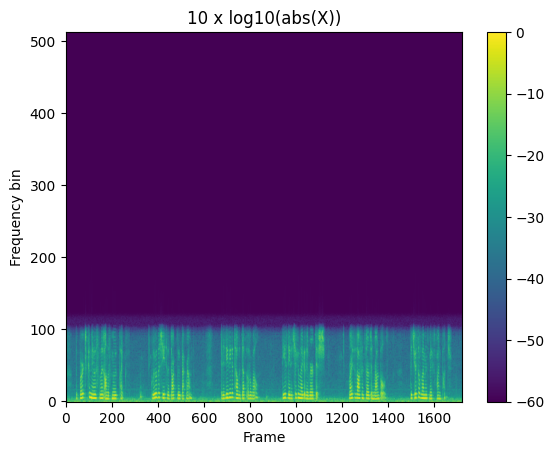

In [42]:
plot_spectrogram(spectrogram)

### Quantized Spectrogram

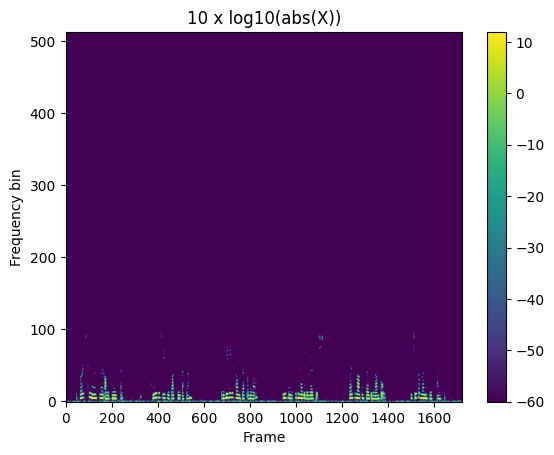

In [43]:
plot_spectrogram(quantized_spectrogram)

In [44]:
dequantized_spetrogram  = dequantize(quantized_spectrogram, 5)
reconstruction          = compute_inverse_spectrogram(dequantized_spetrogram, fft_size=fft_size, hop_size=hop_size) 

In [45]:
Audio(data = reconstruction, rate = 44100)

### Answers
If we quantize the spectrogram using a low number of bits, we will start losing out on high frequency information. The high frequency content of the ground truth are low in amplitude, thus quantizing them will increase the risk of them being rounded to zero. The resuklt therefore sounds muffled/filtered/unclear and is almost uninteligible.

The problem of previous sounds is that amplitudes are typically higher for low-frequencies, so after quantization high-frequencies typically are rounded directly to zero. Let's apply sub-band quantization in order to deal with this problem. We can emulate that by applying an amplification factor to each frequency subband. Let's define the following bands (given N as fft_size):

| Band      | Start | End | Amplitude factor|
| ----------- | ----------- | ----------- | ------- |
| 1      | 0       | N/32 | 1 |
| 2  | N/32        | N/16| 2 |
| 3  | N/16        | N/8| 4 |
| 4   | N/8        | N/4| 8 |
| 5  | N/4        | last (i.e. N/2 + 1)| 16 |

**b) Amplify these frequency bands of the spectrogram by the given amplitude factor before quantizing, and let's divide by these amplitude factor before resynthesizing audio. How does it sound after that process?**

Tips: integer division in python is done using `//` operator. e.g.:
```
X[:, N//32:N//16] = X[:, N//32:N//16] * 2
```

In [46]:
spectrogram[:, fft_size//32:fft_size//16]   = spectrogram[:, fft_size//32:fft_size//16] * 2
spectrogram[:, fft_size//16:fft_size//8]    = spectrogram[:, fft_size//16:fft_size//8] * 4
spectrogram[:, fft_size//8:fft_size//4]     = spectrogram[:, fft_size//8:fft_size//4] * 8
spectrogram[:, fft_size//4:fft_size//(fft_size + 1)] = spectrogram[:, fft_size//4:fft_size//(fft_size + 1)] * 16

In [47]:
quantized_spectrogram = quantize(spectrogram, 5)
dequantized_spetrogram  = dequantize(quantized_spectrogram, 5)
reconstruction          = compute_inverse_spectrogram(dequantized_spetrogram, fft_size=fft_size, hop_size=hop_size)

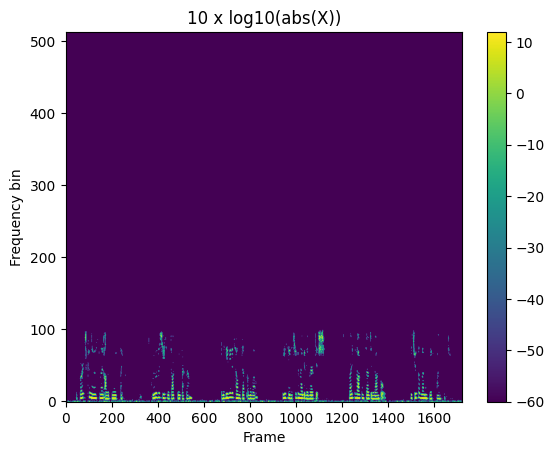

In [49]:
plot_spectrogram(quantized_spectrogram)

In [48]:
Audio(data = reconstruction, rate = 44100)

### Answers

- The audio sounds a lot clearer in the high frequency range and we are able to understand the speech again
- The spectrogram also shows that there is more high frequency content than in the one that doesn't apply amplitude correction to the frequency bins of the signal

# 6.MDCT vs. DFT

**a) Check MDCT python package documentation: https://mdct.readthedocs.io/en/latest/ and (1) extract the MDCT "spectrogram" from a waveform (read from `speech.wav`), (2) reconstruct the waveform from the previously computed spectrogram. How does it sound this reconstructed signal?**

**Tip: ignore warnings coming from `mdct` code**

In [55]:
import mdct
spectrogram         = mdct.mdct(audio)
new_reconstruction  = mdct.icmdct(spectrogram)

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [56]:
Audio(data = new_reconstruction, rate = 44100)

NameError: name 'new_reconstruction' is not defined

**b) How many numbers must we encode in the MDCT spectrogram? Take into account MDCT values are real, not complex :) Any interesting observation?**

**c) Apply quantization with 8 bits to the signal. How does it sound?**

**Use `save_quantized_real_matrix_to_file` to store this MDCT spectrogram in a file using 8 bits and Huffman encoding. What's the size of the file? Use `load_quantized_real_matrix_from_file` to reconstruct the audio from this file.**

**It is quite interesting the fact that it is able to generate such a high quality audio with a such small amount of information. Why can't DFT do the same thing?**